# Fine-tuning DETR for Structure Detection

The following notebook should be run to replicate the training of the DETR model on our custom dataset of electric structure images and their corresponding annotations (COCO JSON files). Please run in Google Colab or on a PC with a GPU for best results.

This fine-tuning references methods from the following Github Repo: https://github.com/woctezuma/finetune-detr

### Feature Initialization

Initialize the functions and variables required throughout the notebook to work with COCO JSON annotations and DETR

In [1]:
# Import torch and ensure that CUDA is available. If not, please run on Google Colab
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

torch.set_grad_enabled(False);

2.1.0+cu118 True


In [2]:
import torchvision.transforms as T

# PyTorch image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Functions to process bounding boxes in outputs
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [3]:
# Filter the bounding boxes that have low confidence
def filter_bboxes_from_outputs(outputs,threshold=0.7):
    
    # Retain predictions above the given threshold
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    probas_to_keep = probas[keep]

    # Scale bounding boxes
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

    return probas_to_keep, bboxes_scaled

In [4]:
# COCO category classes for demo
CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

# Colors for COCO visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

In [5]:
import matplotlib.pyplot as plt

# Function to plot the resulting images
def plot_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
        for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
            ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
            cl = p.argmax()
            text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
            ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
        plt.axis('off')
    plt.show()

### DETR Demo

The following provides a sample representation of the object detection capabilities of the DETR model on a sample image.

In [6]:
# Load in the pretrained DETR model
model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=True)
model.eval();

Downloading: "https://github.com/facebookresearch/detr/zipball/main" to /root/.cache/torch/hub/main.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 101MB/s]
Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth" to /root/.cache

In [7]:
from PIL import Image
import requests

# Load in a sample image for DETR demo
url = 'http://images.cocodataset.org/train2017/000000310645.jpg'
im = Image.open(requests.get(url, stream=True).raw)

In [8]:
# Normalize the input image and run the image through the model
img = transform(im).unsqueeze(0)
outputs = model(img)

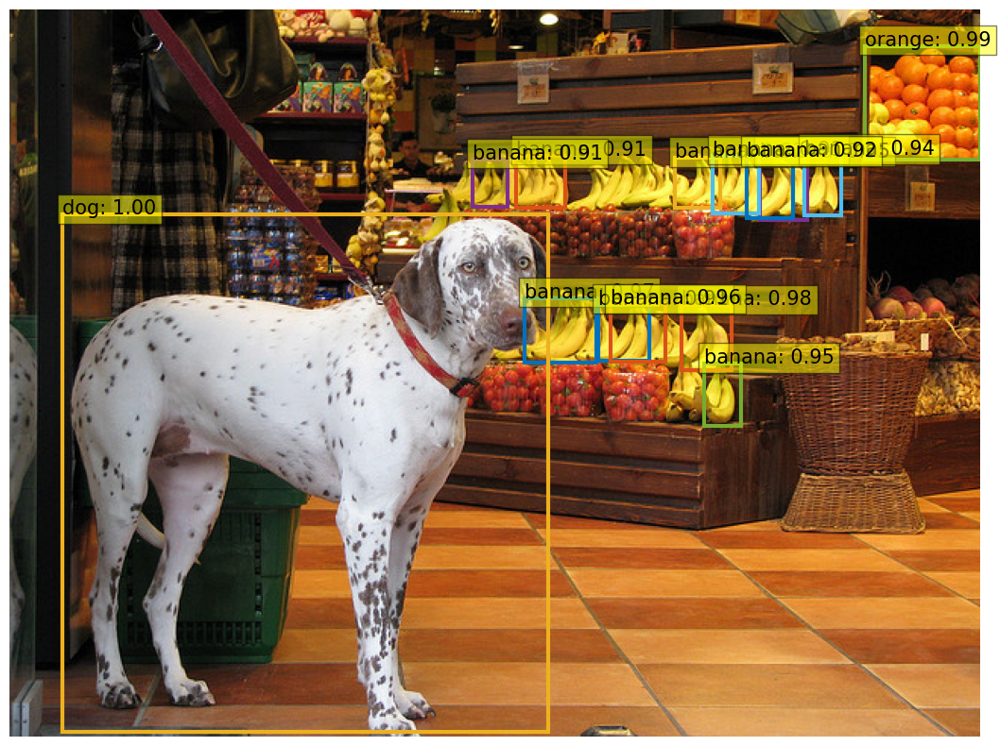

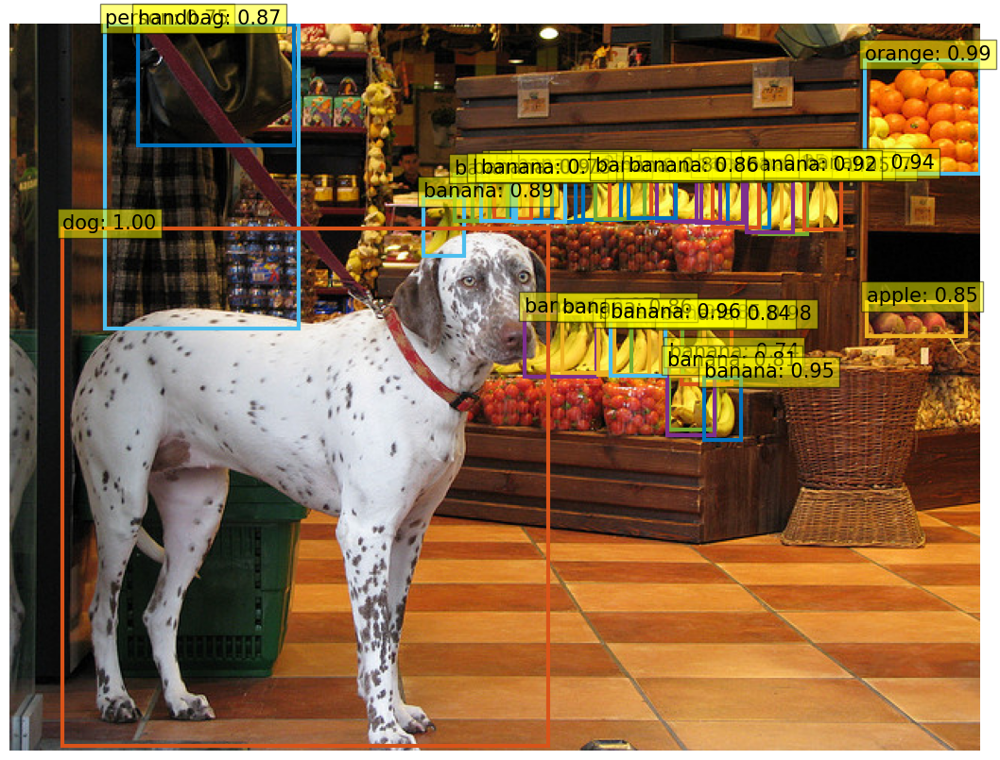

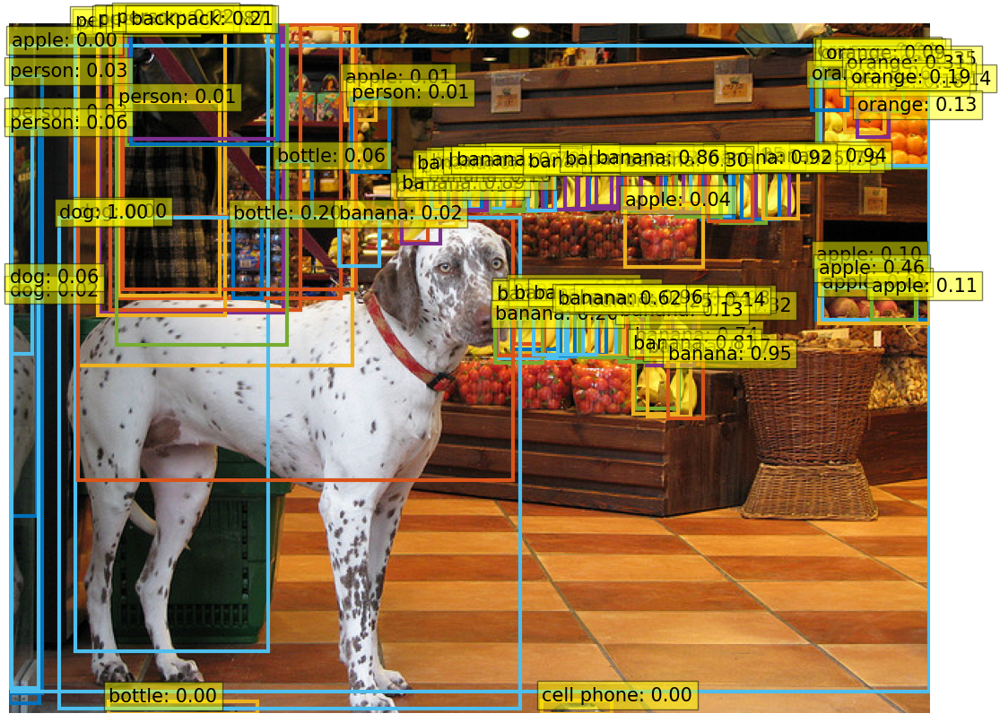

In [9]:
# Display the DETR results
for threshold in [0.9, 0.7, 0.0]:
    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                            threshold=threshold)
    plot_results(im, probas_to_keep, bboxes_scaled)

As seen in the images above, the DETR model, in each iteration of the image, presents further inspections of the image with its deductions on the target object within the photo. Accordingly, the number of bounding boxes increase as DETR inspects further with less confidence.

For each bounding box, a label and DETR's confidence in the labeling are reflected next to the box. With each iteration of the results, the bounding boxes with lower confidence levels appear more frequently.

### Clone DETR Branch

Clone the following DETR [fork](https://github.com/woctezuma/detr/tree/finetune) which will allow for training on a custom dataset.

In [ ]:
# ONLY run if running outside of Google Colab
!mkdir -p content

In [ ]:
# Run this cell regardless of server
%cd /content/

!rm -rf detr
!git clone https://github.com/woctezuma/detr.git

%cd detr/

!git checkout finetune

### Initialize Pre-Trained Weights

Load a pre-trained model checkpoint for DETR so that we can utilize the model without training it on a large dataset for ourselves. This is particularly useful in light of fine-tuning the model.

Different DETR checkpoint URL's can be found here:https://github.com/facebookresearch/detr#model-zoo

In [11]:
# Get pretrained weights
checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)

# Remove class weights
del checkpoint["model"]["class_embed.weight"]
del checkpoint["model"]["class_embed.bias"]

torch.save(checkpoint,
           'detr-r50_no-class-head.pth')

### Create Necessary Directories

Run the following cell to create a series of needed directories.

In [ ]:
# Create a series of directories for data to be stored
!mkdir -p /content/data/structures/annotations/
!mkdir -p /content/data/custom/train2017/
!mkdir -p /content/data/custom/val2017/

In order for the DETR model to be trained, please now upload:
- custom_train.json
- custom_val.json
- All training images that do not begin with 'kevin_'
- All validation images that begin with 'kevin_'

The directory structure should reflect the following:
```
path/to/coco/
├ annotations/  # JSON annotations
│  ├ annotations/custom_train.json
│  └ annotations/custom_val.json
├ train2017/    # training images
└ val2017/      # validation images
```

### Load In and Inspect Custom Data Set

To ensure that the structure data has been loaded in correctly, we will display the annotations of randomly selected samples in the training set:
-   Reference of COCO API Functionality: https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocoDemo.ipynb

In [12]:
# Select 0 or 1 to being indexing image categories. We will begin with 1
first_class_index = 1

In [26]:
# Import necessary packages
%matplotlib inline
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

In [37]:
# Initialize filepaths to the training data and train JSON
dataDir='/content/data/structures/'
dataType='train2017'
annFile='{}annotations/custom_train.json'.format(dataDir)

In [48]:
# Load the training JSON file through COCO
coco=COCO(annFile)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [39]:
# Observe COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())

nms=[cat['name'] for cat in cats]
print('Categories: {}'.format(nms))

nms = set([cat['supercategory'] for cat in cats])
print('Super-categories: {}'.format(nms))

Categories: ['OH', 'UG']
Super-categories: {''}


Above, we observe that in our image labeling, there exist two categories of labels:
- OH: Overhead Structures (poles)
- UG: Underground Structures (electrical boxes)

There exist no super-categories, or, overarching categories of structures.

In [40]:
# Load the image and category IDs
catIds = coco.getCatIds(catNms=['OH', 'UG']);
imgIds = coco.getImgIds(catIds=catIds );

Image n°106
Image name: /content/data/structures//train2017/UG_2_v4_f60.jpg


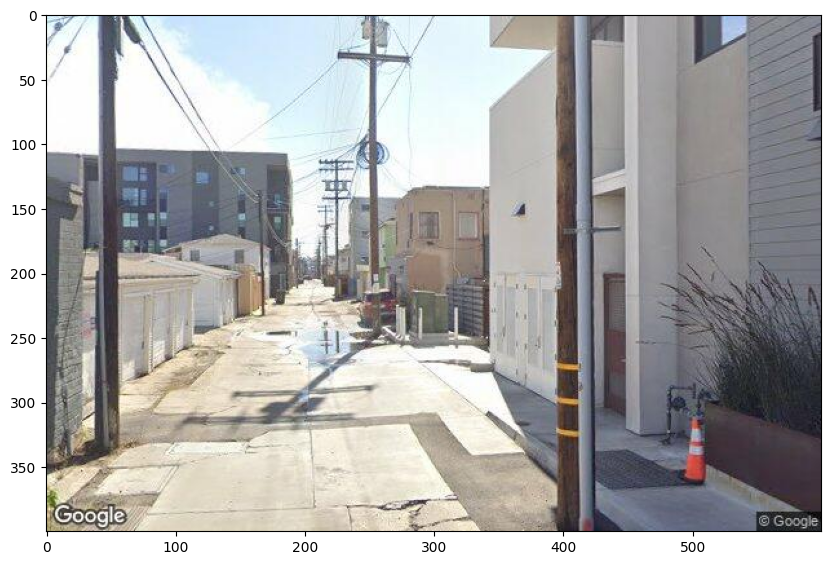

In [42]:
# Choose a random image from the training set and display
img_id = imgIds[np.random.randint(0,len(imgIds))]
print('Image n°{}'.format(img_id))

img = coco.loadImgs(img_id)[0]

img_name = '%s/%s/%s'%(dataDir, dataType, img['file_name'])
print('Image name: {}'.format(img_name))

I = io.imread(img_name)
plt.figure()
plt.imshow(I)

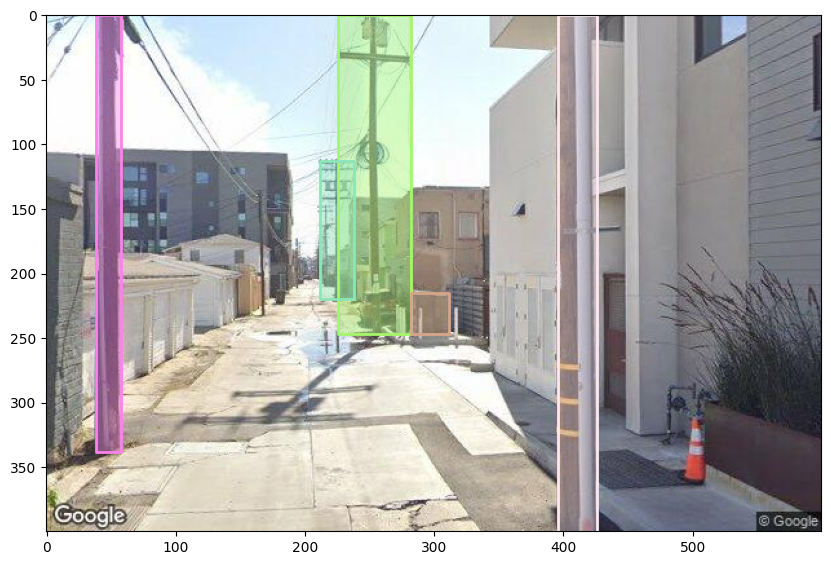

In [44]:
# Obtain the annotations/label that correspond with this image
annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds)
anns = coco.loadAnns(annIds)

# Display the image with its bounding boxes
plt.imshow(I)
coco.showAnns(anns, draw_bbox=True)

Above, we see a randomly selected image from our training set and bounding boxes around poles and underground structures. These boxes are dervied from out COCO JSON file, wherein boxes were manually bound for the purpose of training DETR.

### Fine-tuning DETR with Custom Data Set

In [45]:
assert(first_class_index in [0, 1])

if first_class_index == 0:
    # There are two classes (OH and UG) with ID n°1 and n°2.
    num_classes = 2
    finetuned_classes = ['OH', 'UG']

else:
    # DETR assumes that indexing starts with 0, so there is a dummy class with ID n°0.
    num_classes = 3
    finetuned_classes = ['N/A', 'OH', 'UG']

print('First class index: {}'.format(first_class_index))
print('Parameter num_classes: {}'.format(num_classes))
print('Fine-tuned classes: {}'.format(finetuned_classes))

First class index: 1
Parameter num_classes: 3
Fine-tuned classes: ['N/A', 'OH', 'UG']


In [46]:
%cd /content/detr/

/content/detr


Run the following cell to train the model on the training dataset on 10 epochs.

In [49]:
# This is used to actually train the model
!python main.py \
  --dataset_file "custom" \
  --coco_path "/content/data/structures/" \
  --output_dir "outputs" \
  --resume "detr-r50_no-class-head.pth" \
  --num_classes $num_classes \
  --epochs 10

Not using distributed mode
git:
  sha: e891373a8cab93d3719afb0acff28de94c6dc6a3, status: clean, branch: finetune

Namespace(lr=0.0001, lr_backbone=1e-05, batch_size=2, weight_decay=0.0001, epochs=10, lr_drop=200, clip_max_norm=0.1, frozen_weights=None, backbone='resnet50', dilation=False, position_embedding='sine', enc_layers=6, dec_layers=6, dim_feedforward=2048, hidden_dim=256, dropout=0.1, nheads=8, num_queries=100, pre_norm=False, masks=False, aux_loss=True, set_cost_class=1, set_cost_bbox=5, set_cost_giou=2, mask_loss_coef=1, dice_loss_coef=1, bbox_loss_coef=5, giou_loss_coef=2, eos_coef=0.1, num_classes=3, dataset_file='custom', coco_path='/content/data/structures/', coco_panoptic_path=None, remove_difficult=False, output_dir='outputs', device='cuda', seed=42, resume='detr-r50_no-class-head.pth', start_epoch=0, eval=False, num_workers=2, world_size=1, dist_url='env://', distributed=False)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The p

## Observation of Model Results

### Training Results

Reference: https://github.com/lessw2020/Thunder-Detr/blob/master/View_your_training_results.ipynb

In [50]:
from util.plot_utils import plot_logs

from pathlib import Path

log_directory = [Path('outputs/')]

As mentioned in the code of [`plot_logs`](https://github.com/facebookresearch/detr/blob/5e66b4cd15b2b182da347103dd16578d28b49d69/util/plot_utils.py#L13):
-   Solid lines are training results
-   Dashed lines are validation results

/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(


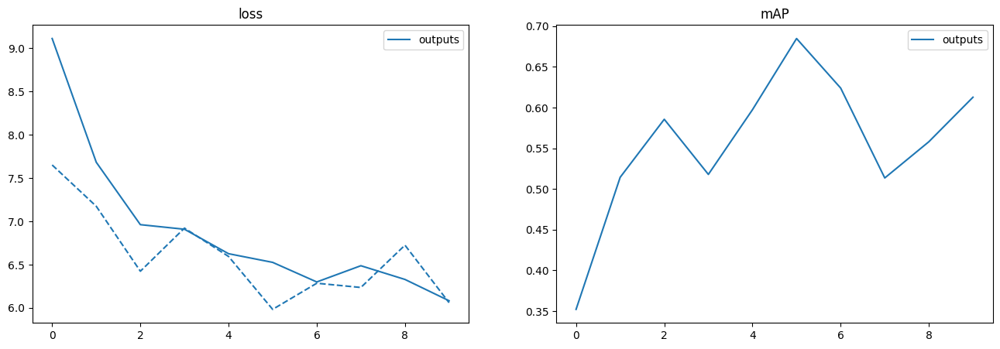

In [51]:
# Plot the loss and mAP (mean average precision) over 10 epochs
fields_of_interest = (
    'loss',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operat

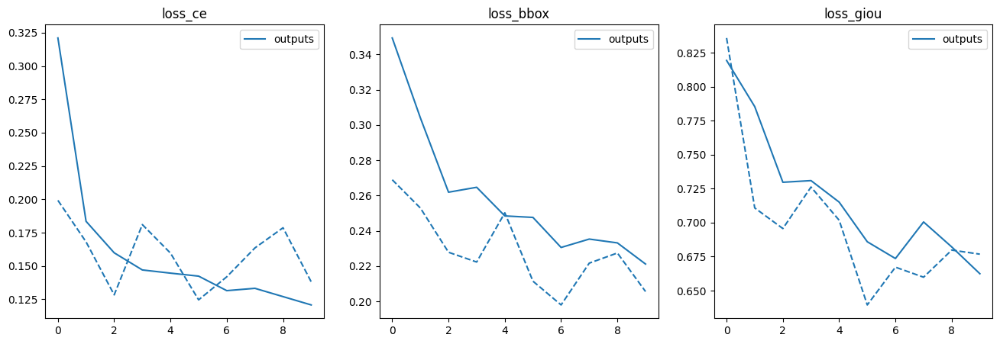

In [52]:
# Plot the class error, bounding box, and GIOU (Generalized Intersection Over Union) losses
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)

/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/root/.cache/torch/hub/facebookresearch_detr_main/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(


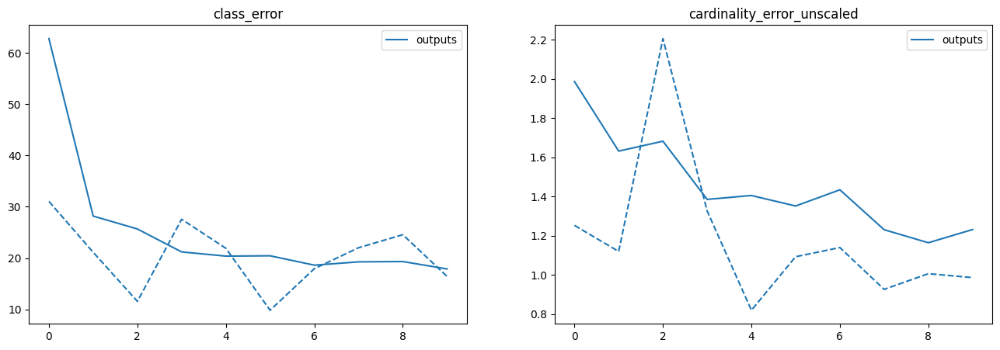

In [53]:
# Plot the class error and cardinality error
fields_of_interest = (
    'class_error',
    'cardinality_error_unscaled',
    )

plot_logs(log_directory,
          fields_of_interest)

### Load the Fine-Tuned Model

In [54]:
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=num_classes)

checkpoint = torch.load('outputs/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


### Display Fine-tuned Results

In [55]:
def plot_finetuned_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
        for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
            ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
            cl = p.argmax()
            text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
            ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [56]:
def run_worflow(my_image, my_model):
  # mean-std normalize the input image (batch-size: 1)
  img = transform(my_image).unsqueeze(0)

  # propagate through the model
  outputs = my_model(img)

    for threshold in [0.9, 0.7]:

        probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                                  threshold=threshold)

        plot_finetuned_results(my_image,
                               probas_to_keep,
                               bboxes_scaled)

### Display Training Image Results

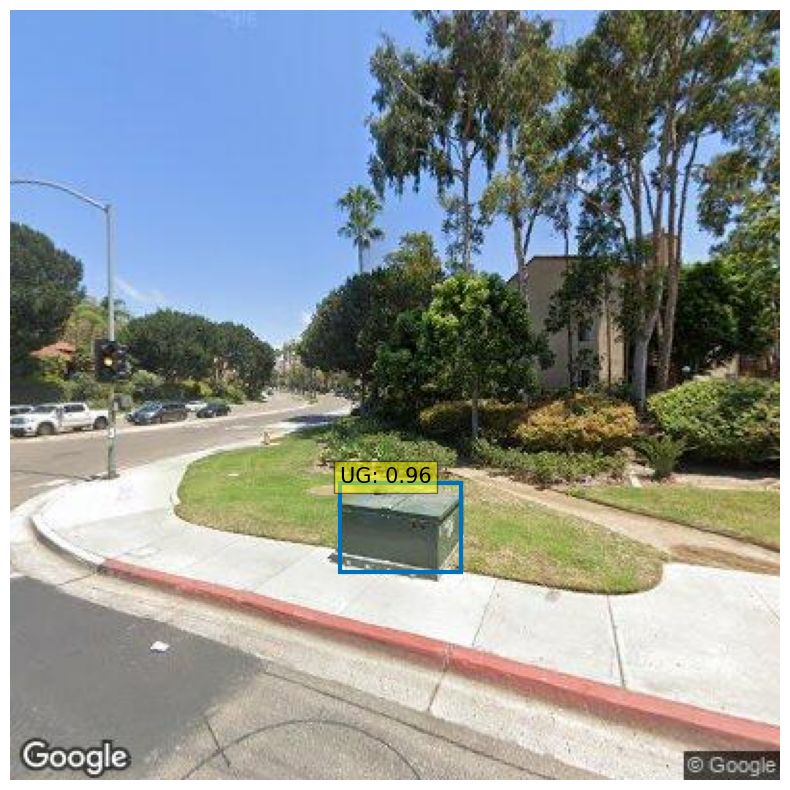

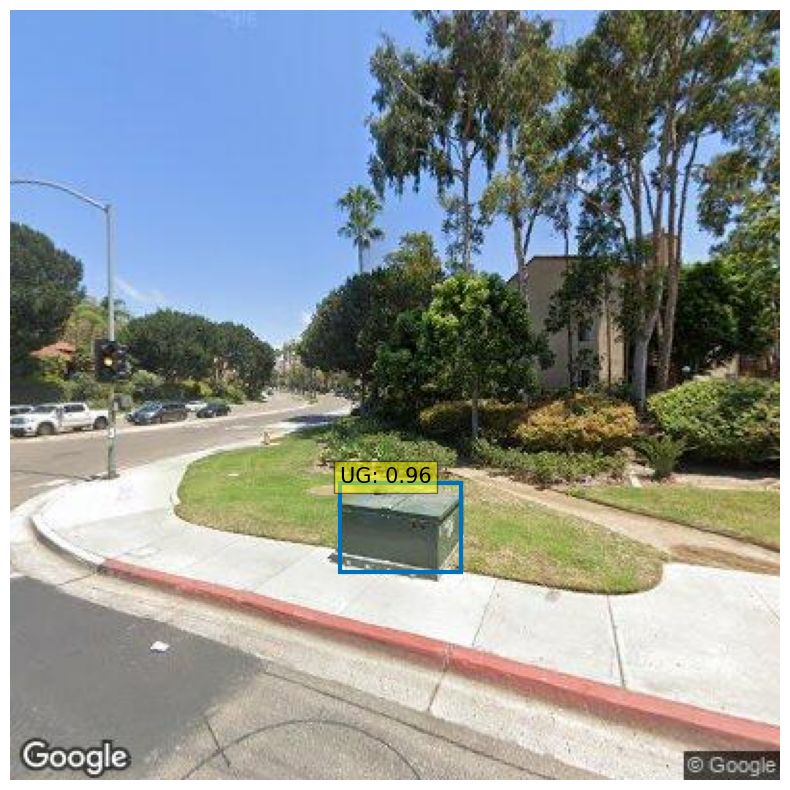

In [57]:
from PIL import Image

img_name = '/content/data/structures/train2017/D150379_3_90.jpg'
im = Image.open(img_name)

run_worflow(im,
            model)

### Display Validation Image Results

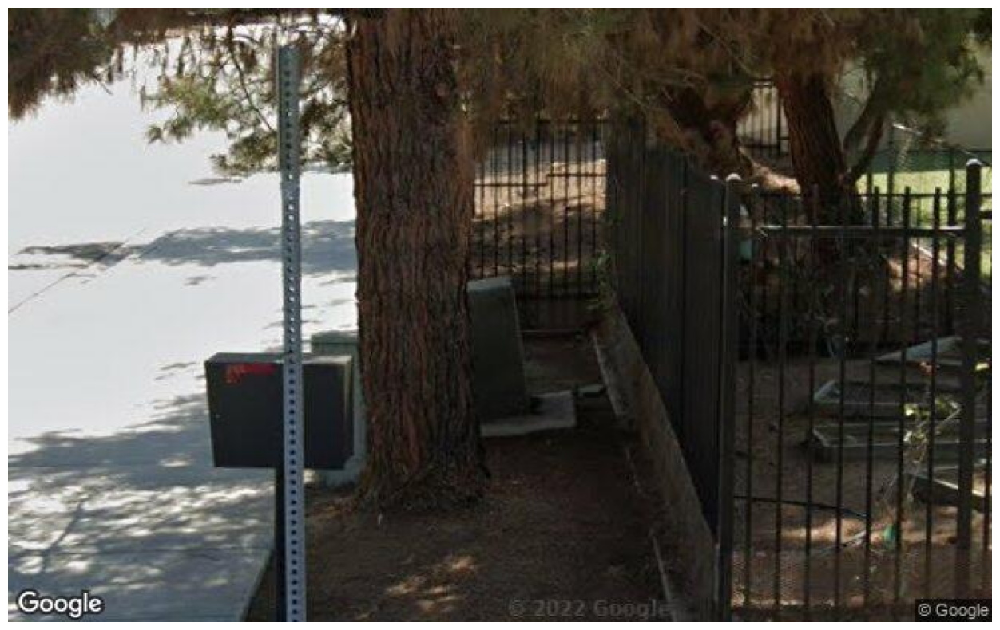

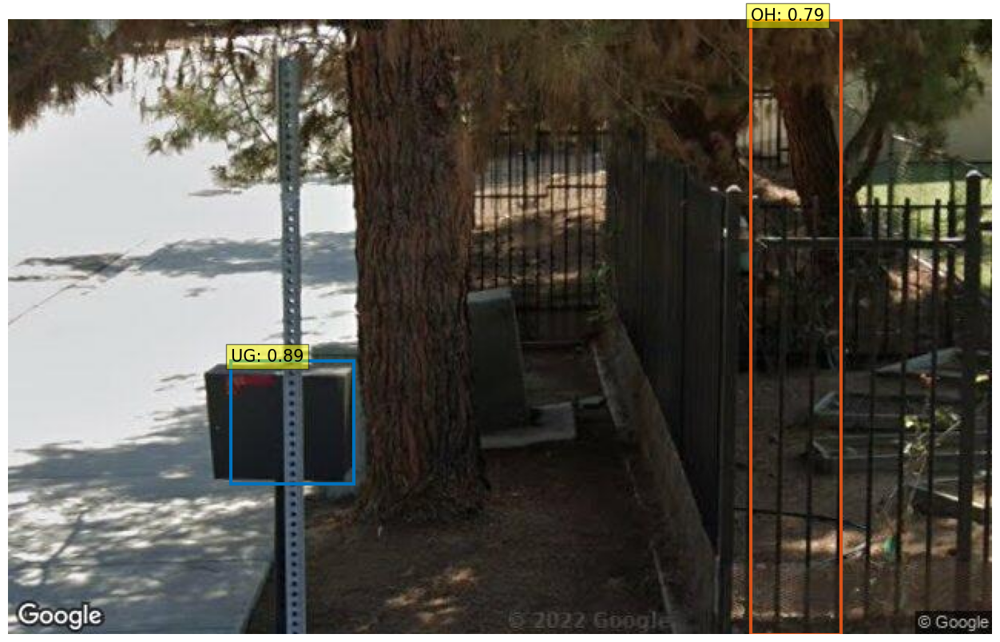

In [58]:
from PIL import Image

img_name = '/content/data/structures/val2017/kevin_images_D139887_0_0.jpg'
im = Image.open(img_name)

run_worflow(im,
            model)

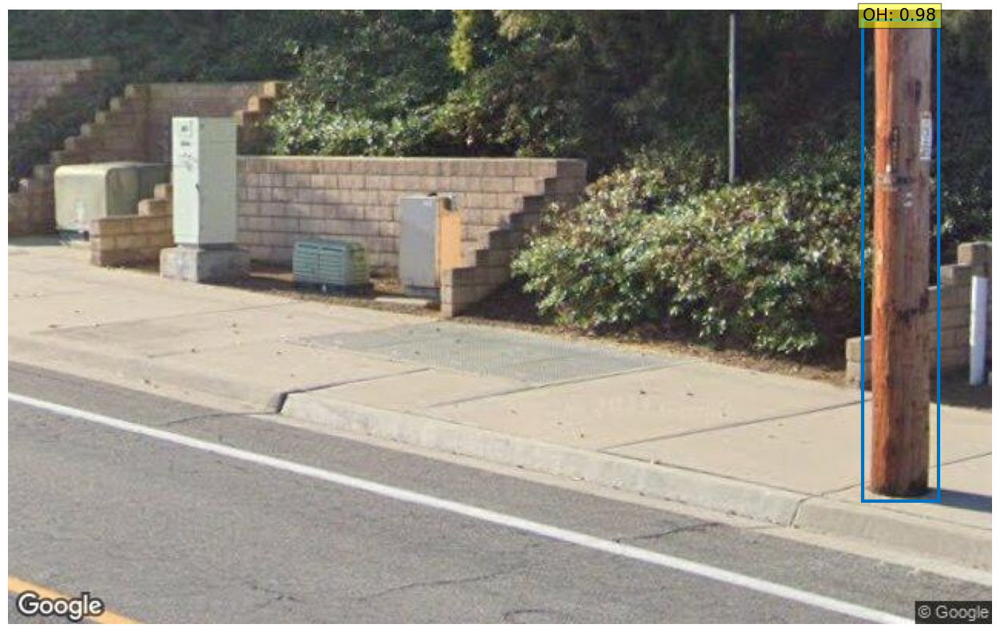

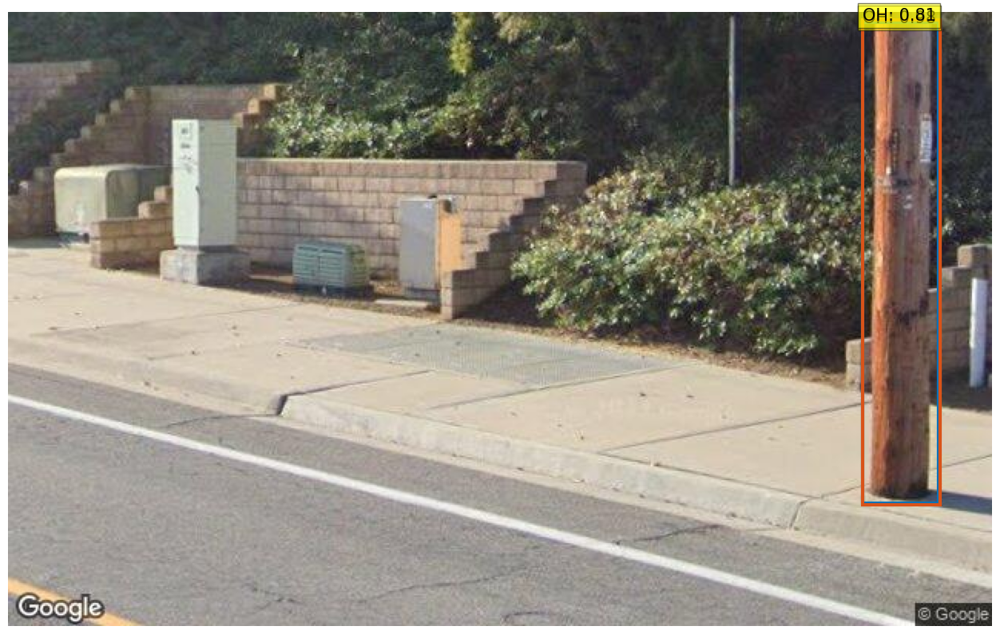

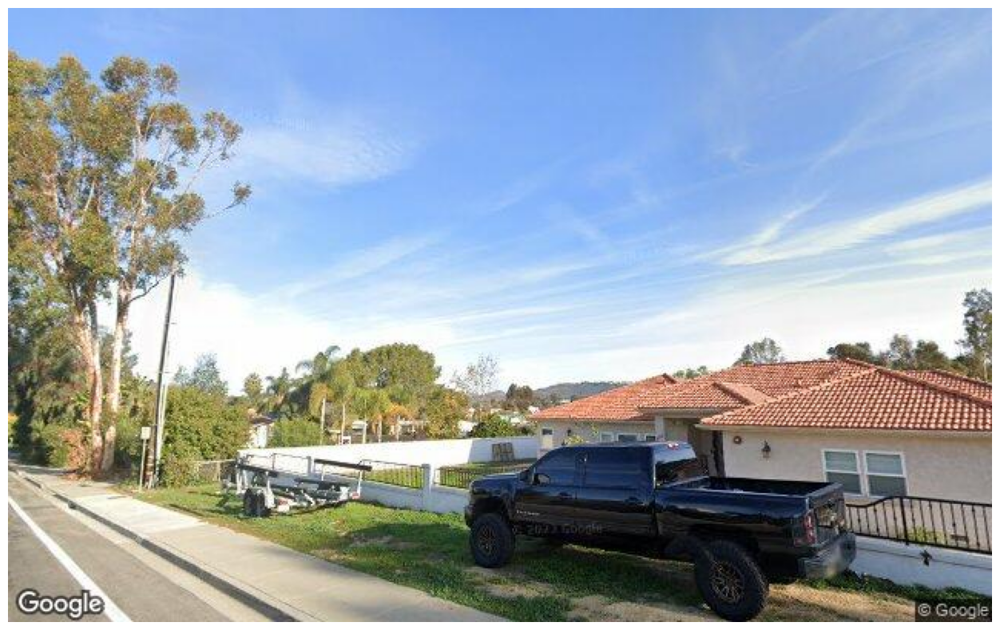

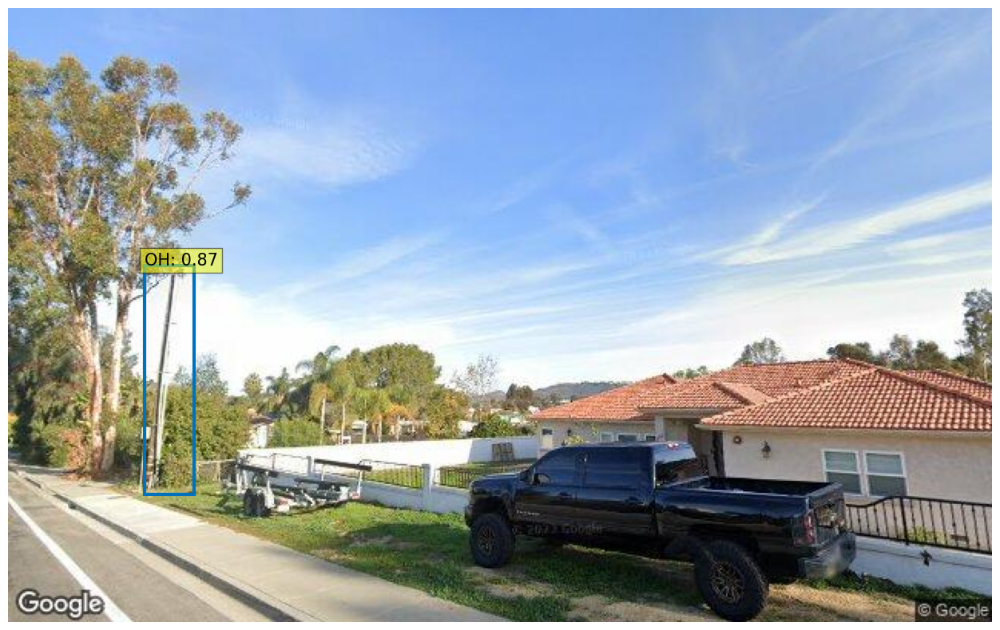

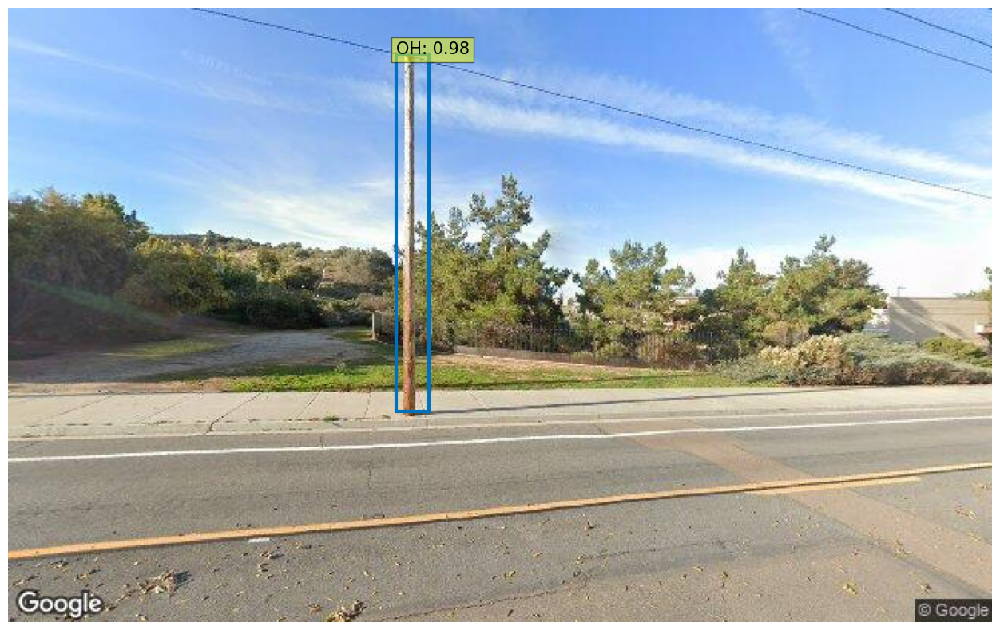

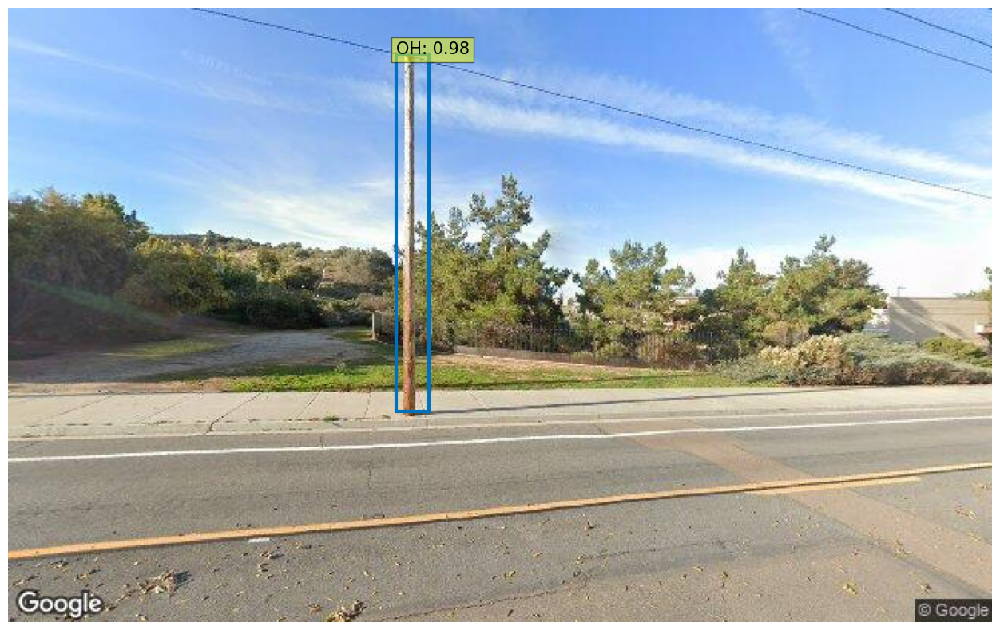

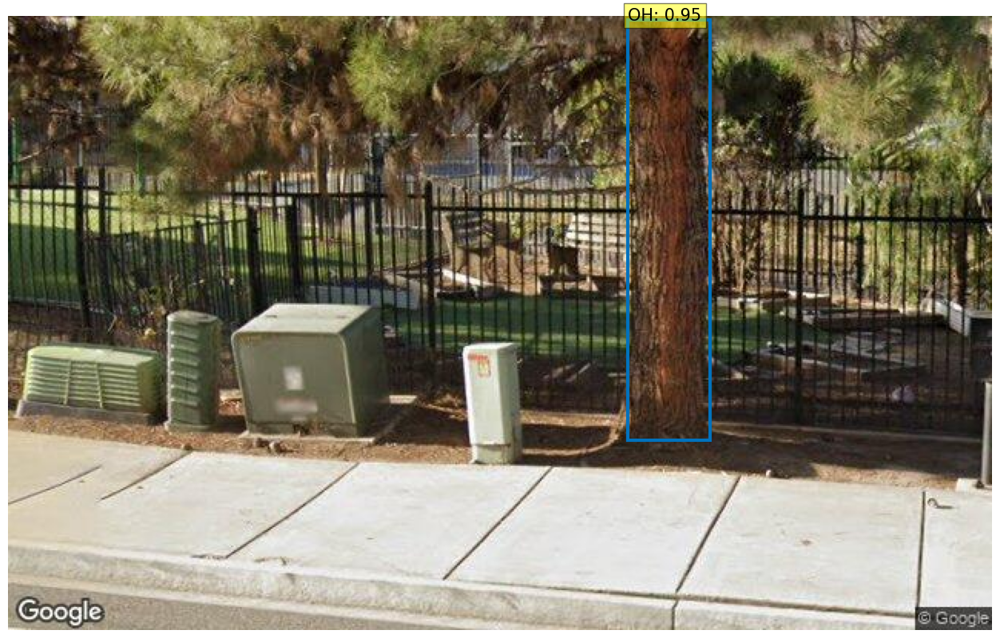

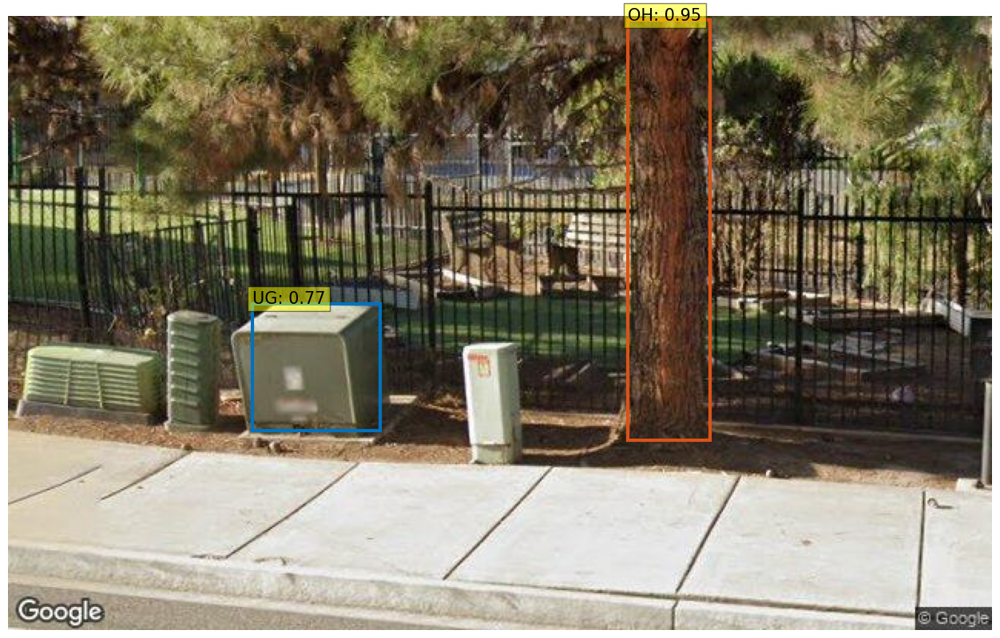

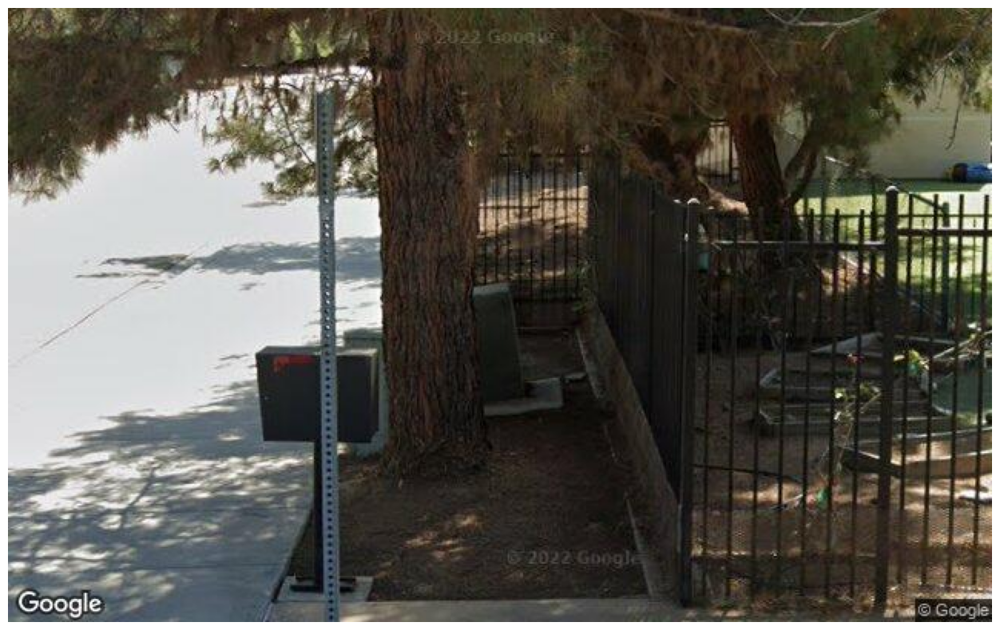

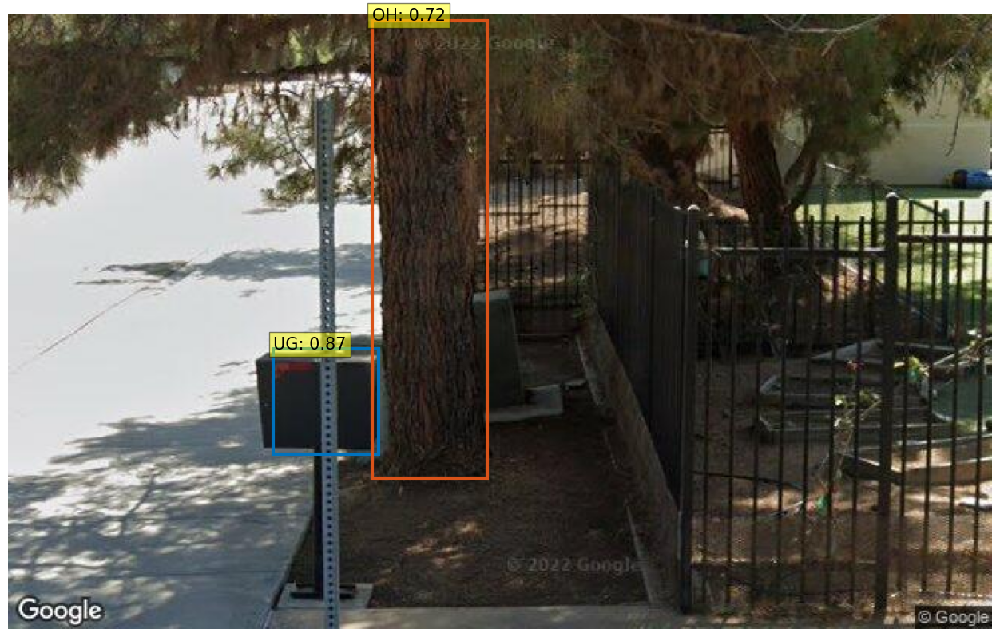

In [71]:
# Display validation results on set of 5 images
from glob import glob

val_images = glob('/content/data/structures/val2017/*.jpg')
for i, img_name in enumerate(val_images):
    if i == 5:
        break
    im = Image.open(img_name)
    
    run_worflow(im,model)